**Aviso para los estudiantes:** Esta pauta es solamente una referencia ilustrativa de la distribución de puntajes estándar utilizada para la corrección de la T4. Sin embargo, se revisaron algunas tareas con el cuerpo docente completo (incluyendo al profesor) para discutir sobre descuentos asociados y puntajes parciales, por si en algún caso su puntaje no coincide de manera exacta con la pauta.

**Nota:** Tal como se comentó por un anuncio hecho en Canvas, para esta tarea se tendrá en cuenta muchos más aspectos que la T3, como el orden, la claridad de las respuestas, etc. Respuestas que tengan código sin comentar o que no tengan justificación no serán considerados. Además, nos reservamos el derecho de aplicar descuentos sobre casos bordes no contemplados en la pauta.

<H1> Nombre:</H1>
<H1> Apellido:</H1>
<H1> Número de alumno:</H1>

#Pregunta 1

In [1]:
!gdown --id 15Z0tkJW6NTdvi9q0G3vQDgRyniXzqEzG
!unzip diamonds.zip 

Downloading...
From: https://drive.google.com/uc?id=15Z0tkJW6NTdvi9q0G3vQDgRyniXzqEzG
To: /content/diamonds.zip
100% 712k/712k [00:00<00:00, 11.3MB/s]
Archive:  diamonds.zip
  inflating: diamonds.csv            


In [ ]:
import pandas as pd
import numpy as np
# from keras.utils.np_utils import to_categorical #En caso de que se utilice keras hay una versión simple de esta función
def to_categorical(y, num_classes):
    for (i, num) in enumerate(y):
        if i == 0:
            y_cat = np.eye(num_classes)[num].reshape(1, num_classes)
        else:
            y_cat = np.concatenate((y_cat, np.eye(num_classes)[num].reshape(1, num_classes)), axis=0)
    
    return y_cat

In [ ]:
df = pd.read_csv('diamonds.csv')
columns = df.columns
print(columns)
print(df.shape)
df.head()

Index(['Unnamed: 0', 'carat', 'cut', 'color', 'clarity', 'depth', 'table',
       'price', 'x', 'y', 'z', 'Usage'],
      dtype='object')
(53940, 12)


,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z,Usage
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,ToV
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,Test
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,ToV
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,ToV
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,ToV


In [ ]:
nullnp = df.isnull().to_numpy().astype('float64')
print(sum(nullnp))
#No se aprecian elementos nulos en la matriz

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [ ]:
clonednp = df.duplicated().to_numpy().astype('float64')
print(sum(clonednp))
#No se aprecian elementos duplicados en la matriz

0.0


Necesitamos como mínimo que la matriz no contenga elementos que no puedan leer las librerías. Una limpieza básica parte por encontrar elementos nulos o que no son números (**NaN**). Podríamos considerar con este criterio la limpieza de los elementos que son strings, pero esto lo tenemos considerado aparte. Sin embargo, es algo que se debe hacer antes de construir las matrices *X* e *y*.

Otro elemento básico a agregar es la eliminación de duplicados. Estos elementos no tienen un efecto generador de errores a nivel de código, pero sí a nivel de metodología, pues estropean la representación estadística de los datos con respecto al problema. Obviamente un elemento duplicado lo es a lo largo de toda la medición. Las categorías repetidas en series discretas no son duplicados, a menos que toda la fila lo sea (incluyendo a los elementos de punto flotante).

**Puntos por limpiar el set con cierta eficacia, o corroborarlo limpio: 0.3**

In [ ]:
doesnotmatter = [columns[0]]
int_series = list(columns[2:5])
float_series = [columns[1]] + list(columns[5:7]) + list(columns[8:11])
target = columns[7]
print(f'Series que no importan {doesnotmatter}')
print(f'Series entera por transformar a número {int_series}')
print(f'Series para trabajo en punto flotante {float_series}')
print(f'Serie para regresión {[target]}')

Series que no importan ['Unnamed: 0']
Series entera por transformar a número ['cut', 'color', 'clarity']
Series para trabajo en punto flotante ['carat', 'depth', 'table', 'x', 'y', 'z']
Serie para regresión ['price']


In [ ]:
for col in columns:
    print(col, df[col].nunique())

Unnamed: 0 53940
carat 273
cut 5
color 7
clarity 8
depth 184
table 127
price 11602
x 554
y 552
z 375
Usage 2


Para las características de **cut**, **color** y **clarity**, tenemos una cantidad de 5, 7 y 8 elementos no numéricos por serie, respectivamente. Buscamos una transformación para codificar estos elementos categóricos en números que las librerías de ANN puedan leer. 

En este caso podemos construir una trasnformación arbitraria de un string a un entero. La propiedad de buen orden de los números enternos no nos interesa, basta con que cada categoría quede bien representada.

In [ ]:
#Codificación en enteros, en caso de no utilizar una librería para esto
transform = {}
for col in int_series:
    transformation = df[col].unique()
    dict_transform = {}
    for (i, elem) in enumerate(transformation):
        dict_transform[elem] = i

    transform[col] = dict_transform
    print(dict_transform)

{'Ideal': 0, 'Premium': 1, 'Good': 2, 'Very Good': 3, 'Fair': 4}
{'E': 0, 'I': 1, 'J': 2, 'H': 3, 'F': 4, 'G': 5, 'D': 6}
{'SI2': 0, 'SI1': 1, 'VS1': 2, 'VS2': 3, 'VVS2': 4, 'VVS1': 5, 'I1': 6, 'IF': 7}


**Puntos por codificar los elementos categóricos: 0.3**

Esto quiere decir que utiliza todas las características. Más adelante se hace una codificación One Hot, pero esto no es un requisito. Alternativa:

**Decide construir la matriz sin elementos categóricos: 0.2**

Puede continuar con el problema, pero esto le va a costar más adelante. 

In [ ]:
for group in df.groupby(['Usage']):
    if group[0] == 'ToV':
        train_df = group[1].copy().reset_index()
    else:
        test_df = group[1].copy().reset_index()

In [ ]:
#Matrices con codificación entera

def buildXy(localdf):
    X = []
    y = []

    for i in range(len(localdf)):
        
        floatfeatures = [0]*len(float_series)
        for (j, col) in enumerate(float_series):
            floatfeatures[j] = localdf[col][i]

        intfeatures = [0]*len(int_series)
        for (j, col) in enumerate(int_series):
            intfeatures[j] = transform[col][localdf[col][i]]
        
        features = floatfeatures + intfeatures
        X.append(features)

    X = np.array(X)
    y = localdf[target].to_numpy()
    
    return X, y

X_train, y_train = buildXy(train_df)
X_test, y_test = buildXy(test_df)

print(f'Tamaño de X train: {X_train.shape}', f'Tamaño de y train: {y_train.shape}')
print(f'Tamaño de X test: {X_test.shape}', f'Tamaño de y test: {y_test.shape}')

Tamaño de X train: (48590, 9) Tamaño de y train: (48590,)
Tamaño de X test: (5350, 9) Tamaño de y test: (5350,)


**Puntos por construir la matriz de características con el vector objetivo: 0.4**

La mayoría de los alumnos llegarán hasta este punto. Algunos pueden querer construir matrices de características orientadas a mejorar la regresión. Una opción relativamente sencilla es utilizar una codificación one hot para los datos categóricos, pues no agranda demasiado la matriz y logra una mejor separación de clases en cada serie. Se aprovecha del hecho de que los datos no están ordenados para agregarlos a espacios ortogonales en los que dicho orden no importa, pero se mantiene una distancia inicial no sesgada entre ellos. Se toma un poco de tiempo de cómputo, pero vale la pena.

In [ ]:
#Matrices con codificación one hot

def buildOneHotXy(localdf):
    X = []  
    localdf2 = localdf.copy()

    for i in range(len(localdf)):
        
        floatfeatures = [0]*len(float_series)
        for (j, col) in enumerate(float_series):
            floatfeatures[j] = localdf[col][i]

        for col in int_series:
            localdf2[col][i] = transform[col][localdf[col][i]]

        X.append(floatfeatures)

    X = np.array(X)

    for (j, col) in enumerate(int_series):
        num_cats = len(transform[col])
        npcol = np.array(to_categorical(localdf2[col], num_classes=num_cats))
        if j == 0:
            Xa = npcol
        else:
            Xa = np.concatenate((Xa, npcol), axis=1)

    y = localdf[target].to_numpy()
    X = np.concatenate((X, Xa), axis=1)
    return X, y

X_train, y_train = buildOneHotXy(train_df)
X_test, y_test = buildOneHotXy(test_df)

print(f'Tamaño de X train: {X_train.shape}', f'Tamaño de y train: {y_train.shape}')
print(f'Tamaño de X test: {X_test.shape}', f'Tamaño de y test: {y_test.shape}')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Tamaño de X train: (48590, 26) Tamaño de y train: (48590,)
Tamaño de X test: (5350, 26) Tamaño de y test: (5350,)


Esta párte no vale puntos extra, pero puede ayudar a obtener mejor desempeño, lo que puede ser útil más adelante.

**Nota al corrector**: El archivo que usted ha recibido ha sido corrido con esta matriz para el entrenamiento y pruebas de las redes neuronales. Si necesita comparar con un entrenamiento sin esta codificación puede volver a correr los códigos. Si lo hace tiene que elegir qué librería utilizar o de lo contrario los códigos de la otra librería pueden reescribir las matrices u otras variables. Se ha ordenado el notebook para que resulte conveniente para la corrección, no para volver a correr los códigos por lo que debe cuidar de no utilizar opciones como "Ejecutar todo", o equivalentes. Debe elegir una librería e ir ejecutando las celdas que son exclusivas de esa librería en cada pregunta.

#Pregunta 2

En este caso utilizaremos la más simple de las estrategias, la normalización, pues se espera que la mayoría de los alumnos la aplique. En general es una de las mejores elecciones, pues es simple de entender, y casi siempre funciona a mejora del desempeño del modelo.

En términos simples una normalización es una transformación del tipo escalado de los datos. Con ello se busca estandarizar las entradas para tener una medida común de comparación (típicamente entre 0 y 1), reduciendo las anomalías. Típicamente se debe escalar cada característica según su propia distribución de probabilidades, realizando suposiciones de distibución Normal, o normalización residual (T de student) cuando no se cuenta con los parámetros conocidos de la distribución de probabilidades.

En este contexto utilizaremos las herramientas de sklearn, que por defecto realizan una normalización L2. Si bien se puede cambiar esto, se espera que una mayoría de alumnos haga lo mismo (o utilice la opción 'Max', que también es equivalente a la normalización manual más fácil de construir).

In [ ]:
from sklearn.preprocessing import normalize
X_train = normalize(X_train)
X_test = normalize(X_test)

**Puntos por preprocesar: 0.4**

Se pueden aplicar otros preprocesamientos, incluso algunos más complejos como el análisis de componentes principales (PCA) o asignación de latentes de Dirichlet (LDA), pero al final vale lo mismo que en puntaje acá. Eso sí, bien hecho puede mejorar de manera importante el desempeño, pero no estamos evaluando tanto. Con suerte esto les ayudaría más adelante.

La división del set de entrenamiento la realizamos a 80% sobre el ToV, y el 20% restante para validación. Necesitamos una cantidad importante de datos a entrenar, en especial para la parte de aprendizaje profundo, o para el agregado de hiperparámetros con muchas neuronas. Es posible que utilicemos modelos con alta cantidad de parametros por lo que no podemos desperdiciar datos de entrenamiento.

Por otro lado, tenemos un objetivo duro de puntaje de MAE (bien explícito), que podríamos no alcanzar, por lo que necesitamos un buen set de validación para que no pierda representatividad con respecto al test. No podemos reducir mucho el tamaño de este set.

No necesitamos explicar lo que sucede son el set de test pues es dado. 

In [ ]:
# from sklearn.model_selection import train_test_split
# X_train, X_valid, y_train, y_valid = train_test_split(Xo, yo, test_size=0.1)
# Aquí irían esos códigos descomentados pero, para facilitar la rejecución de las celdas de keras o pytorch, solo se incluirán en la parte de pytorch

**Puntos por justificación: 0.6**

No hay puntos por el split. Incluso será peor si no lo hacen pues procederán a descuentos si utilizan set de test para validar.

#Pregunta 3

In [ ]:
import copy
import torch.nn as nn
import matplotlib.pyplot as plt
from prettytable import PrettyTable

In [ ]:
#Muchas veces es útil tener los hiperparámetros de exploración en diccionarios para poder leer mejor el código
neurons = {'input': [100, 80, 60, 40, 20], 'hidden': [20, 40, 60, 80, 100]}
activations = {'keras': ['relu', 'tanh', 'sigmoid'], 'pytorch': [nn.ReLU(), nn.Tanh(), nn.Sigmoid()]}

In [ ]:
def plot_history(history, abslim=150, sqrtlim=1000):
    hist = pd.DataFrame(history) #Se transforma en dataframe solo por facilidad
    hist.head()

    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Abs Error [MPG]')
    plt.plot(hist['epochs'], hist['mae'],
            label='Train Error')
    plt.plot(hist['epochs'], hist['val_mae'],
            label = 'Val Error')
    plt.ylim([0,abslim])
    plt.legend()

    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Square Error [$MPG^2$]')
    plt.plot(hist['epochs'], hist['mse'],
            label='Train Error')
    plt.plot(hist['epochs'], hist['val_mse'],
            label = 'Val Error')
    plt.ylim([0,sqrtlim])
    plt.legend()
    plt.show()

##Keras

In [ ]:
import keras
from keras.layers import Dense
from keras.models import Sequential
# from keras.utils.np_utils import to_categorical #ya usado arriba solo está aqui por si aparece
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.models import load_model

In [ ]:
mlp = Sequential() #Definición del modelo
mlp.add(Dense(100, input_shape=(X_train.shape[1],), activation='relu'))
mlp.add(Dense(20, activation='relu'))
mlp.add(Dense(1))
mlp.summary()#Realizamos una prueba para ver si estamos construyendo bien el modelo

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 100)               2700      
_________________________________________________________________
dense_1 (Dense)              (None, 20)                2020      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 21        
Total params: 4,741
Trainable params: 4,741
Non-trainable params: 0
_________________________________________________________________


La cantidad de parámetros parece adecuada para la cantidad de muestras del set de entrenamiento. Con esto tenemos un modelo con suficiente representación (varios parámetros, y por lo tanto complejidad), pero que no posee una cantidad excesiva de parámetros que podría inducir sobreajuste.

In [ ]:
def buildMLP(input_shape, input_neuron, hidden_neuron, activation):
    #Definición del modelo, utilizamos una función como buena práctica para no
    #repetir innecesariamente código.
    mlp = Sequential() 
    mlp.add(Dense(input_neuron, input_shape=(input_shape,), activation=activation))
    mlp.add(Dense(hidden_neuron, activation=activation))
    mlp.add(Dense(1))
    mlp.compile(loss='mse', optimizer='adam', metrics=['mae', 'mse'])
    return mlp

In [ ]:
table_mae = PrettyTable() #Dos tablas, una para mae y la otra para mse
table_mse = PrettyTable()
labels = ['(Input, Hidden) / Act. fn']
for act_fn in activations['keras']:
    labels.append(act_fn)

table_mae.field_names = copy.deepcopy(labels)
table_mse.field_names = copy.deepcopy(labels)

all_history = [[[]]*3]*5 #Estructura para guardar la evolución de los entrenamientos para no volver a entrenar más tarde una vez escogido el mejor modelo

for i in range(5): #Tabla de 5x3, iteramos primero sobre las filas
    
    init_row = ['(' + str(neurons['input'][i]) + ', ' + str(neurons['hidden'][i]) + ')']
    table_mae_row = copy.deepcopy(init_row)
    table_mse_row = copy.deepcopy(init_row)

    for j in range(3):
        mlp = buildMLP(X_train.shape[1], 
                       neurons['input'][i], 
                       neurons['hidden'][i], 
                       activations['keras'][j])
        
        mc = ModelCheckpoint(init_row[0] + '_' + activations['keras'][j] + '.h5', 
                             monitor='val_mae', 
                             mode='min', 
                             verbose=0, 
                             save_best_only=True) #Esta clase permite guardar el modelo actualizado al mejor valor de mae en validación en la época x
        
        history = mlp.fit(X_train, 
                          y_train, 
                          epochs=50, 
                          batch_size=32, 
                          verbose=0, 
                          validation_split=0.2, 
                          callbacks=[mc])        
        
        all_history[i][j] = history.history
        all_history[i][j]['epochs'] = history.epoch
        
        mae = '{:.2f}'.format(min(all_history[i][j]['val_mae']))
        mse = '{:.2f}'.format(min(all_history[i][j]['val_mse']))
        table_mae_row.append(mae)
        table_mse_row.append(mse)

    table_mae.add_row(table_mae_row)
    table_mse.add_row(table_mse_row)

print('Resultados de MAE en validación')
print(table_mae)
print('')
print('Resultados de MSE en validación')
print(table_mse)


Resultados de MAE en validación
+---------------------------+--------+--------+---------+
| (Input, Hidden) / Act. fn |  relu  |  tanh  | sigmoid |
+---------------------------+--------+--------+---------+
|         (100, 20)         | 260.38 | 777.70 | 1031.78 |
|          (80, 40)         | 318.00 | 440.78 |  440.78 |
|          (60, 60)         | 333.75 | 440.89 |  237.99 |
|          (40, 80)         | 318.02 | 199.33 |  275.40 |
|         (20, 100)         | 322.16 | 193.25 |  310.24 |
+---------------------------+--------+--------+---------+

Resultados de MSE en validación
+---------------------------+-----------+-----------+------------+
| (Input, Hidden) / Act. fn |    relu   |    tanh   |  sigmoid   |
+---------------------------+-----------+-----------+------------+
|         (100, 20)         | 471558.84 | 734298.75 | 1238123.75 |
|          (80, 40)         | 525307.75 | 340634.94 | 340668.06  |
|          (60, 60)         | 623376.31 | 340722.34 |  95903.75  |
|          

Mejor modelo con MAE de 193.25 con 20 neuronas de entrada, 100 en la capa oculta, y función de activación tanh.

In [ ]:
best_mlp = load_model('(20, 100)_tanh.h5')
results = best_mlp.evaluate(X_test, y_test, verbose=1)

168/168 [==============================] - 0s 1ms/step - loss: 17416696.0000 - mae: 2236.8909 - mse: 17416696.0000


¿Qué pasó? ¿Supestamente era el mejor modelo?

Las funciones de activación tanh y sigmoide pueden saturar muy rápidamente. Lo que se está observando es un sobreajuste y una pésima generalización. En ese caso lo mejor es utilizar ReLU.

La otra forma de arreglar esto es normalizando el valor ground thruth de precio, y luego aplicando una transformación inversa para recuperar tanto las métricas como una predicción precisa. El problema que tiene este método es que satura el valor máximo de predicción del modelo. Si los alumnos optan por este camino deberían analizar bien las consecuencias si conocen la teoría o aceptar un poco menos de puntaje.

In [ ]:
best_mlp = load_model('(20, 100)_relu.h5')
results = best_mlp.evaluate(X_test, y_test, verbose=1)

168/168 [==============================] - 0s 888us/step - loss: 1347142.8750 - mae: 631.3069 - mse: 1347142.8750


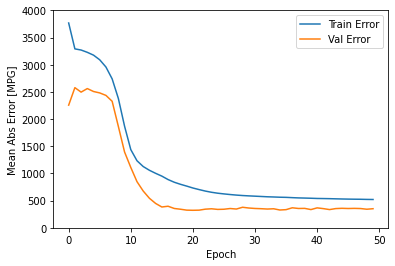

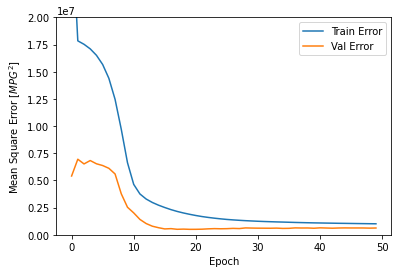

In [ ]:
plot_history(all_history[4][0], abslim=4e3, sqrtlim=2e7)

Ambas métricas tienen una buena correlación con los sets de entrenamiento y validación. Se puede observar que hay una tendencia asíntótica de seguimiento del cada valor en ambos sets. Esto lleva a pensar que No solo hay buena correlación estadística entre los sets, sino que el modelo puede encontrar un punto estable de convergencia. Esta tendencia es menos notoria al inicio del entrenamiento, donde la capacidad de generalización desde el set de entrenamiento a validación se ve reducida.

Sin embargo, la verdadera generalización que nos interesa se debe encontrar entre los sets de validación y test. En este caso, el modelo no generaliza muy bien, encontrando valores de MAE dentro de lo pedido, pero muy por encima de los predichos por validación.

##Pytorch

In [ ]:
import torch
from torch import Tensor
from torch.nn import Sequential, Linear
from torch.nn import ReLU
from torch.nn import MSELoss
from torch.optim import Adam
from torchvision import transforms as tfs
from torch.utils.data import Dataset, DataLoader

In [ ]:
!pip install torch-summary

In [ ]:
from collections import OrderedDict
arch_small = OrderedDict([('input', Linear(X_train.shape[1], 100)),
                         ('relu1', ReLU()),
                         ('hidden', Linear(100, 20)),
                         ('relu2', ReLU()),
                         ('output', Linear(20, 1))])
mlp = Sequential(arch_small)

In [ ]:
from torchsummary import summary

summary(mlp, (1, X_train.shape[1])) #Realizamos una prueba para ver si estamos construyendo bien el modelo

Layer (type:depth-idx)                   Output Shape              Param #
├─Linear: 1-1                            [-1, 1, 100]              2,700
├─ReLU: 1-2                              [-1, 1, 100]              --
├─Linear: 1-3                            [-1, 1, 20]               2,020
├─ReLU: 1-4                              [-1, 1, 20]               --
├─Linear: 1-5                            [-1, 1, 1]                21
Total params: 4,741
Trainable params: 4,741
Non-trainable params: 0
Total mult-adds (M): 0.00
Input size (MB): 0.00
Forward/backward pass size (MB): 0.00
Params size (MB): 0.02
Estimated Total Size (MB): 0.02


Layer (type:depth-idx)                   Output Shape              Param #
├─Linear: 1-1                            [-1, 1, 100]              2,700
├─ReLU: 1-2                              [-1, 1, 100]              --
├─Linear: 1-3                            [-1, 1, 20]               2,020
├─ReLU: 1-4                              [-1, 1, 20]               --
├─Linear: 1-5                            [-1, 1, 1]                21
Total params: 4,741
Trainable params: 4,741
Non-trainable params: 0
Total mult-adds (M): 0.00
Input size (MB): 0.00
Forward/backward pass size (MB): 0.00
Params size (MB): 0.02
Estimated Total Size (MB): 0.02

La cantidad de parámetros parece adecuada para la cantidad de muestras del set de entrenamiento. Con esto tenemos un modelo con suficiente representación (varios parámetros, y por lo tanto complejidad), pero que no posee una cantidad excesiva de parámetros que podría inducir sobreajuste.

In [ ]:
def buildMLP(input_shape, input_neuron, hidden_neuron, activation):
    #Definición del modelo, utilizamos una función como buena práctica para no
    #repetir innecesariamente código.
    arch_small = OrderedDict([('input', Linear(input_shape, input_neuron)),
                         ('activ1', activation),
                         ('hidden', Linear(input_neuron, hidden_neuron)),
                         ('activ2', activation),
                         ('output', Linear(hidden_neuron, 1))])
    mlp = Sequential(arch_small)
    return mlp

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.2)

In [ ]:
class SimpleDataset(Dataset):
    def __init__(self, input_data, labels):
        self.inputs = torch.Tensor(input_data)
        self.labels = torch.Tensor(labels)

    def __getitem__(self, idx):
        # labels = torch.Tensor(self.labels[idx])
        # inputs = torch.Tensor(self.inputs[idx])
        
        return self.labels[idx], self.inputs[idx]

    def __len__(self):
        return len(self.labels)

train_set = SimpleDataset(X_train, y_train)
valid_set = SimpleDataset(X_valid, y_valid)
test_set = SimpleDataset(X_test, y_test)

train_loader = DataLoader(train_set, batch_size=32, shuffle=True)
valid_loader = DataLoader(valid_set, batch_size=32, shuffle=False)
test_loader = DataLoader(test_set, batch_size=32, shuffle=False)

In [ ]:
def epoch(model, loader, istrain=True):
    optimizer = Adam(model.parameters(), lr=1e-3)
    lossfn = MSELoss()

    if istrain:
        model.train()
    else:
        model.eval()

    # mse = 0
    # mae = 0

    for (labels, input) in loader:
        prediction = model(input.float())#Se calcula una prediccion en el tensor de salida prediction
        optimizer.zero_grad()#El optimizador establece su gradiente en cero
        loss = lossfn(prediction.view(-1), labels.float())#Se calcula la perdida
        if istrain:
            loss.backward()
            optimizer.step()#Se calculan los gradientes y se aplica un paso de actualizacion de pesos
    #     mse += loss.item() / labels.shape[0]
    #     mae += torch.abs(prediction.view(-1) - labels).sum() / labels.shape[0]

    # mse /= len(loader)
    # mae /= len(loader)

    y_pred, y_true = predict(model, loader)
    mae = np.absolute(y_pred - y_true).mean()
    mse = ((y_pred - y_true) * (y_pred - y_true)).mean()

    return mae, mse

def predict(model, loader):
    model.eval()

    for (i, (labels, input)) in enumerate(loader):
        pred = model(input.float())
        if i == 0:
            prediction = pred
        else:
            prediction = torch.cat((prediction, pred), dim=0)

        if i == 0:
            ground_truth = labels
        else:
            ground_truth = torch.cat((ground_truth, labels), dim=0)        

    return prediction.view(-1).detach().numpy(), ground_truth.detach().numpy()

In [ ]:
table_mae = PrettyTable() #Dos tablas, una para mae y la otra para mse
table_mse = PrettyTable()
labels = ['(Input, Hidden) / Act. fn']
for act_fn in activations['keras']:
    labels.append(act_fn)

table_mae.field_names = copy.deepcopy(labels)
table_mse.field_names = copy.deepcopy(labels)

all_history = [[[]]*3]*5 #Estructura para guardar la evolución de los entrenamientos para no volver a entrenar más tarde una vez escogido el mejor modelo
epochs = 50

for i in range(5): #Tabla de 5x3, iteramos primero sobre las filas
    
    init_row = ['(' + str(neurons['input'][i]) + ', ' + str(neurons['hidden'][i]) + ')']
    table_mae_row = copy.deepcopy(init_row)
    table_mse_row = copy.deepcopy(init_row)

    for j in range(3):
        mlp = buildMLP(X_train.shape[1], 
                       neurons['input'][i], 
                       neurons['hidden'][i], 
                       activations['pytorch'][j])
        
        history = {'mae': [0]*epochs, 'mse': [0]*epochs, 'val_mae': [0]*epochs, 'val_mse': [0]*epochs, 'epochs': [0]*epochs}
        best_mae = 1e10

        for ep in range(epochs):
            history['mae'][ep], history['mse'][ep] = epoch(mlp, train_loader, istrain=True)
            history['val_mae'][ep], history['val_mse'][ep] = epoch(mlp, valid_loader, istrain=False)
            history['epochs'][ep] = ep
            
            if history['val_mae'][ep] < best_mae: #Este bloque permite guardar el modelo actualizado al mejor valor de mae en validación en la época x
                best_mae = history['val_mae'][ep]
                data = {'model_params': {'input': neurons['input'][i], #Guardamos los datos de los hiperparámetros pues, a diferencia de keras, la carga es sobre un modelo instanciado
                                         'hidden': neurons['hidden'][i], 
                                         'activation': activations['keras'][j]}, 
                        'weights': mlp.state_dict(),
                        'val_mae': history['val_mae'][ep], 
                        'val_mse': history['val_mse'][ep]}
                torch.save(data, init_row[0] + '_' + activations['keras'][j] + '.pth') #Utilizamos el parámetro de Keras solo pues es un string adecuado al caso
        
        all_history[i][j] = history
        
        mae = '{:.2f}'.format(min(all_history[i][j]['val_mae']))
        mse = '{:.2f}'.format(min(all_history[i][j]['val_mse']))
        table_mae_row.append(mae)
        table_mse_row.append(mse)

    table_mae.add_row(table_mae_row)
    table_mse.add_row(table_mse_row)

print('Resultados de MAE en validación')
print(table_mae)
print('')
print('Resultados de MSE en validación')
print(table_mse)


Resultados de MAE en validación
+---------------------------+--------+---------+---------+
| (Input, Hidden) / Act. fn |  relu  |   tanh  | sigmoid |
+---------------------------+--------+---------+---------+
|         (100, 20)         | 482.58 | 2932.65 | 2935.97 |
|          (80, 40)         | 445.09 | 2753.85 | 2753.85 |
|          (60, 60)         | 447.35 | 2754.00 | 2753.99 |
|          (40, 80)         | 454.82 | 2753.91 | 2753.94 |
|         (20, 100)         | 466.42 | 2753.97 | 2754.04 |
+---------------------------+--------+---------+---------+

Resultados de MSE en validación
+---------------------------+------------+-------------+-------------+
| (Input, Hidden) / Act. fn |    relu    |     tanh    |   sigmoid   |
+---------------------------+------------+-------------+-------------+
|         (100, 20)         | 1000338.75 | 22301888.00 | 22355534.00 |
|          (80, 40)         | 926920.12  | 17604106.00 | 17635116.00 |
|          (60, 60)         | 937711.94  | 156756

Mejor modelo con MAE de 445.09 con 80 neuronas de entrada, 40 en la capa oculta, y función de activación relu. Por lo menos Pytorch no miente y hace las predicciones que corresponden con las funciones de activación respectivas a diferencia de lo que sucede con Keras.

In [ ]:
checkpoint = torch.load('(80, 40)_relu.pth')
act_fn = nn.ReLU() if checkpoint['model_params']['activation'] == 'relu' else \
         nn.Tanh() if checkpoint['model_params']['activation'] == 'tanh' else nn.Sigmoid()
best_mlp = buildMLP(X_train.shape[1], 
                    checkpoint['model_params']['input'], 
                    checkpoint['model_params']['hidden'], 
                    act_fn)
best_mlp.load_state_dict(checkpoint['weights'])
best_mlp.eval()

Sequential(
  (input): Linear(in_features=26, out_features=80, bias=True)
  (activ1): ReLU()
  (hidden): Linear(in_features=80, out_features=40, bias=True)
  (activ2): ReLU()
  (output): Linear(in_features=40, out_features=1, bias=True)
)

In [ ]:
y_pred, y_true = predict(best_mlp, test_loader)
mae = np.absolute(y_pred - y_true).mean()
mse = ((y_pred - y_true) * (y_pred - y_true)).mean()
print(f'Resultado de test, MAE {mae:.2f}, MSE {mse:.2f}')

Resultado de test, MAE 443.06, MSE 665656.00


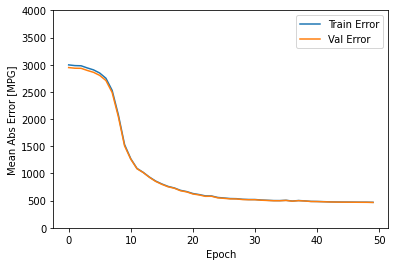

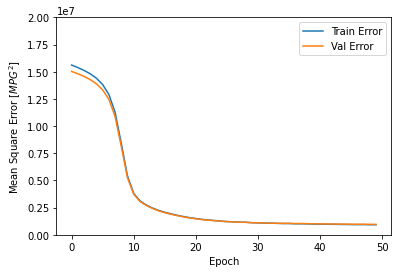

In [ ]:
plot_history(all_history[4][0], abslim=4e3, sqrtlim=2e7)

En este caso tenemos un modelo con un valor de error relativamente grande, pero aceptable dentro de los parámetros. Sin embargo, la generalización es impecable, con solo dos puntos de diferencia entre los sets de validación y test. A nivel de entrenamiento, se puede observar también esta tendencia viendo que las métricas calculadas en el set de validación siguen muy de cerca a aquellas tomadas del set de entrenamiento.

##Asignación de puntajes

**Puntaje por un entrenamiento conjunto de las 5x3 condiciones: 0.3**

**Puntaje por tablas de mae y mse en el set de validación: 0.2**

**Puntaje por prueba del mejor modelo de validación en test: 0.1**

**Puntaje por gráficos de evolución de métricas del mejor modelo: 0.2**

**Puntaje por análisis de correlación de las métricas y generalización: 0.2**

#Pregunta 4

In [ ]:
hiperparameters = {'neurons': [20, 40, 60, 80, 100], 'layers': [1, 2, 3, 4, 5]}

In [ ]:
def plot_regresion(y_test, test_predictions, title, axis=(0,0)):
    plt.scatter(y_test, test_predictions)
    plt.xlabel('True Values [MPG]')
    plt.ylabel('Predictions [MPG]')
    plt.axis('equal')
    plt.axis('square')
    if axis[0] == 0:
        plt.xlim([0,plt.xlim()[1]])
    else:
        plt.xlim([0,axis[0]])
    if axis[1] == 0:
        plt.ylim([0,plt.ylim()[1]])
    else:
        plt.ylim([0,axis[1]])
    plt.title(title)
    plt.plot([-100, 100], [-100, 100])
    plt.show()

In [ ]:
def R2(y_true, y_pred):
    y_mean = y_true.mean()
    ss_tot = ((y_true - y_mean) * (y_true - y_mean)).sum()
    ss_res = ((y_true - y_pred) * (y_true - y_pred)).sum()
    return 1 - ss_res / ss_tot

##Keras

In [ ]:
def buildDeepMLP(input_shape, input_neuron, lasthidden_neuron, hidden_layers, hidden_neuron, activation):
    mlp = Sequential() #Definición del modelo
    mlp.add(Dense(input_neuron, input_shape=(input_shape,), activation=activation)) #Capa de entrada
    for i in range(hidden_layers): #Capas nuevas
        mlp.add(Dense(hidden_neuron, activation=activation))
    mlp.add(Dense(lasthidden_neuron, activation=activation)) #Última capa oculta, la que se preserva del modelo anterior
    mlp.add(Dense(1)) #Capa de salida
    mlp.compile(loss='mse', optimizer='adam', metrics=['mae', 'mse'])
    return mlp

In [ ]:
deep_mlp = buildDeepMLP(X_train.shape[1], 20, 100, 5, 20, 'relu')
deep_mlp.summary()

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_60 (Dense)             (None, 20)                540       
_________________________________________________________________
dense_61 (Dense)             (None, 20)                420       
_________________________________________________________________
dense_62 (Dense)             (None, 20)                420       
_________________________________________________________________
dense_63 (Dense)             (None, 20)                420       
_________________________________________________________________
dense_64 (Dense)             (None, 20)                420       
_________________________________________________________________
dense_65 (Dense)             (None, 20)                420       
_________________________________________________________________
dense_66 (Dense)             (None, 100)             

In [ ]:
table_mae = PrettyTable()
table_mse = PrettyTable()
labels = ['Added layers / Neurons']
for nums in hiperparameters['neurons']:
    labels.append(nums)

table_mae.field_names = copy.deepcopy(labels)
table_mse.field_names = copy.deepcopy(labels)

all_history = [[[]]*5]*5

for i in range(5):
    
    init_row = ['#L' + str(hiperparameters['layers'][i])]
    table_mae_row = copy.deepcopy(init_row)
    table_mse_row = copy.deepcopy(init_row)

    for j in range(5):
        deep_mlp = buildDeepMLP(X_train.shape[1], 20, 100, 
                                hiperparameters['layers'][i], 
                                hiperparameters['neurons'][j], 
                                'relu')
        
        mc = ModelCheckpoint(init_row[0] + '#N' + str(hiperparameters['neurons'][j]) + '.h5', 
                             monitor='val_mae', 
                             mode='min', 
                             verbose=0, 
                             save_best_only=True)
        
        history = deep_mlp.fit(X_train, 
                               y_train, 
                               epochs=50, 
                               batch_size=32, 
                               verbose=0, 
                               validation_split=0.2, 
                               callbacks=[mc])        
        
        all_history[i][j] = history.history
        all_history[i][j]['epochs'] = history.epoch
        
        mae = '{:.2f}'.format(min(all_history[i][j]['val_mae']))
        mse = '{:.2f}'.format(min(all_history[i][j]['val_mse']))
        table_mae_row.append(mae)
        table_mse_row.append(mse)

    table_mae.add_row(table_mae_row)
    table_mse.add_row(table_mse_row)

print('Resultados de MAE en validación')
print(table_mae)
print('')
print('Resultados de MSE en validación')
print(table_mse)


Resultados de MAE en validación
+------------------------+--------+--------+--------+--------+--------+
| Added layers / Neurons |   20   |   40   |   60   |   80   |  100   |
+------------------------+--------+--------+--------+--------+--------+
|          #L1           | 281.86 | 273.42 | 247.16 | 262.52 | 309.19 |
|          #L2           | 252.13 | 252.00 | 272.95 | 257.46 | 239.12 |
|          #L3           | 265.98 | 263.67 | 282.83 | 251.83 | 267.65 |
|          #L4           | 251.86 | 248.42 | 282.03 | 235.72 | 316.08 |
|          #L5           | 261.93 | 320.87 | 352.00 | 271.66 | 293.39 |
+------------------------+--------+--------+--------+--------+--------+

Resultados de MSE en validación
+------------------------+-----------+-----------+-----------+-----------+-----------+
| Added layers / Neurons |     20    |     40    |     60    |     80    |    100    |
+------------------------+-----------+-----------+-----------+-----------+-----------+
|          #L1           |

Seguimos interesados en la métrica MAE. Observamos que en validación el mejor caso se da con cuatro capas y 80 neuronas por capa, para un MAE de 235.72.

In [ ]:
best_deepmlp = load_model('#L4#N80.h5')
results = best_deepmlp.evaluate(X_test, y_test, verbose=1)

168/168 [==============================] - 1s 1ms/step - loss: 407123.6562 - mae: 372.7944 - mse: 407123.6562


Hay una mejora importante en test con respecto a la versión no profunda. Además, todas las métricas de MAE en validación son inferiores a 330, y las de MSE son inferiores a 550000. Revisemos la evolución de este mejor modelo. Para una comparación justa debemos mantener los tamaños de los ejes con respecto al caso anterior.

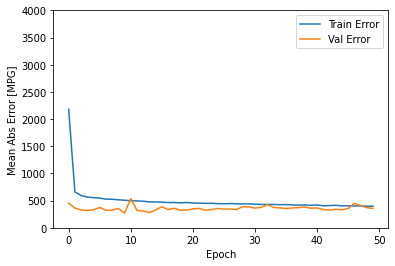

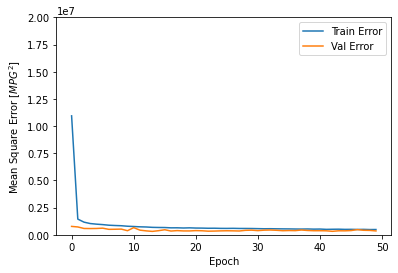

In [ ]:
plot_history(all_history[3][3], abslim=4e3, sqrtlim=2e7)

Se observa que en el caso profundo el modelo converge con mucha mayor velocidad al caso no profundo en este problema. 

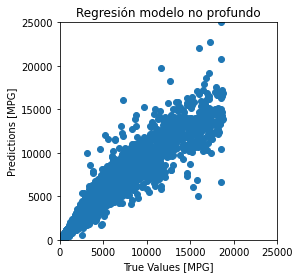

In [ ]:
test_predictions_best_mlp = best_mlp.predict(X_test)
plot_regresion(y_test.flatten(), test_predictions_best_mlp.flatten(), 'Regresión modelo no profundo', axis=[25e3, 25e3])

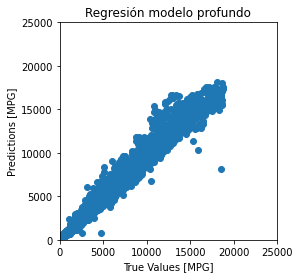

In [ ]:
test_predictions_best_deepmlp = best_deepmlp.predict(X_test)
plot_regresion(y_test.flatten(), test_predictions_best_deepmlp.flatten(), 'Regresión modelo profundo', axis=[25e3, 25e3])

In [ ]:
print(f'Valor R2 del modelo no profundo {R2(y_test.flatten(), test_predictions_best_mlp.flatten()):.4f}')
print(f'Valor R2 del modelo profundo {R2(y_test.flatten(), test_predictions_best_deepmlp.flatten()):.4f}')

Valor R2 del modelo no profundo 0.9156
Valor R2 del modelo profundo 0.9745


La evolución de las métricas del modelo profundo se encuentra en un rango mucho menor a la de las del modelo no profundo, en especial en las primeras épocas. Se nota una convergencia rápida también a comparación. Esta tendencia se mantiene con un valor $R^2$ de ajuste del modelo profundo más alta, mostrando a los puntos del gráfico de precio vs precio más agrupados en una recta y=x.

Como conclusión, y explicación a la mejora, se puede ver que en este caso se aprovecha bien la complejidad extra que ofrece el modelo profundo para solucionar el problema, logrando resultados más precisos. 

##Pytorch

In [ ]:
def buildDeepMLP(input_shape, input_neuron, lasthidden_neuron, hidden_layers, hidden_neuron, activation):
    packed = [('input', Linear(input_shape, input_neuron)), ('activ1', activation)]

    for i in range(hidden_layers + 1):
        if i == 0: #Capa de entrada
            packed += [('hidden' + str(i+1), Linear(input_neuron, hidden_neuron)), 
                      ('activ' + str(i+2), activation)]
        elif i == hidden_layers: #Última capa oculta, la que se preserva del anterior modelo
            packed += [('hidden' + str(i+1), Linear(hidden_neuron, lasthidden_neuron)), 
                      ('activ' + str(i+2), activation)]
        else: #Capas nuevas
            packed += [('hidden' + str(i+1), Linear(hidden_neuron, hidden_neuron)), 
                      ('activ' + str(i+2), activation)]

    packed += [('output', Linear(lasthidden_neuron, 1))] #Capa de salida

    arch_small = OrderedDict(packed)
    mlp = Sequential(arch_small)
    return mlp

In [ ]:
deep_mlp = buildDeepMLP(X_train.shape[1], 80, 40, 5, 20, ReLU())
summary(deep_mlp, (1, X_train.shape[1]))

Layer (type:depth-idx)                   Output Shape              Param #
├─Linear: 1-1                            [-1, 1, 80]               2,160
├─ReLU: 1-2                              [-1, 1, 80]               --
├─Linear: 1-3                            [-1, 1, 20]               1,620
├─ReLU: 1-4                              [-1, 1, 20]               --
├─Linear: 1-5                            [-1, 1, 20]               420
├─ReLU: 1-6                              [-1, 1, 20]               --
├─Linear: 1-7                            [-1, 1, 20]               420
├─ReLU: 1-8                              [-1, 1, 20]               --
├─Linear: 1-9                            [-1, 1, 20]               420
├─ReLU: 1-10                             [-1, 1, 20]               --
├─Linear: 1-11                           [-1, 1, 20]               420
├─ReLU: 1-12                             [-1, 1, 20]               --
├─Linear: 1-13                           [-1, 1, 40]               840
├─Re

Layer (type:depth-idx)                   Output Shape              Param #
├─Linear: 1-1                            [-1, 1, 80]               2,160
├─ReLU: 1-2                              [-1, 1, 80]               --
├─Linear: 1-3                            [-1, 1, 20]               1,620
├─ReLU: 1-4                              [-1, 1, 20]               --
├─Linear: 1-5                            [-1, 1, 20]               420
├─ReLU: 1-6                              [-1, 1, 20]               --
├─Linear: 1-7                            [-1, 1, 20]               420
├─ReLU: 1-8                              [-1, 1, 20]               --
├─Linear: 1-9                            [-1, 1, 20]               420
├─ReLU: 1-10                             [-1, 1, 20]               --
├─Linear: 1-11                           [-1, 1, 20]               420
├─ReLU: 1-12                             [-1, 1, 20]               --
├─Linear: 1-13                           [-1, 1, 40]               840
├─Re

In [ ]:
table_mae = PrettyTable() #Dos tablas, una para mae y la otra para mse
table_mse = PrettyTable()
labels = ['Added layers / Neurons']
for nums in hiperparameters['neurons']:
    labels.append(nums)

table_mae.field_names = copy.deepcopy(labels)
table_mse.field_names = copy.deepcopy(labels)

all_history = [[[]]*5]*5 #Estructura para guardar la evolución de los entrenamientos para no volver a entrenar más tarde una vez escogido el mejor modelo
epochs = 50

for i in range(5): #Tabla de 5x5, iteramos primero sobre las filas
    
    init_row = ['#L' + str(hiperparameters['layers'][i])]
    table_mae_row = copy.deepcopy(init_row)
    table_mse_row = copy.deepcopy(init_row)

    for j in range(5):        
        deep_mlp = buildDeepMLP(X_train.shape[1], 80, 40,
                        hiperparameters['layers'][i], 
                        hiperparameters['neurons'][j], 
                        ReLU())
        
        history = {'mae': [0]*epochs, 'mse': [0]*epochs, 'val_mae': [0]*epochs, 'val_mse': [0]*epochs, 'epochs': [0]*epochs}
        best_mae = 1e10

        for ep in range(epochs):
            history['mae'][ep], history['mse'][ep] = epoch(deep_mlp, train_loader, istrain=True)
            history['val_mae'][ep], history['val_mse'][ep] = epoch(deep_mlp, valid_loader, istrain=False)
            history['epochs'][ep] = ep
            
            if history['val_mae'][ep] < best_mae: #Este bloque permite guardar el modelo actualizado al mejor valor de mae en validación en la época x
                best_mae = history['val_mae'][ep]
                data = {'model_params': {'input': 80, #Guardamos los datos de los hiperparámetros pues, a diferencia de keras, la carga es sobre un modelo instanciado
                                         'lasthidden': 40,
                                         'layers': hiperparameters['layers'][i],
                                         'hidden': hiperparameters['neurons'][j],
                                         'activation': 'relu'}, 
                        'weights': deep_mlp.state_dict(),
                        'val_mae': history['val_mae'][ep], 
                        'val_mse': history['val_mse'][ep]}
                torch.save(data, init_row[0] + '#N' + str(hiperparameters['neurons'][j]) + '.pth')
        
        all_history[i][j] = history
        
        mae = '{:.2f}'.format(min(all_history[i][j]['val_mae']))
        mse = '{:.2f}'.format(min(all_history[i][j]['val_mse']))
        table_mae_row.append(mae)
        table_mse_row.append(mse)

    table_mae.add_row(table_mae_row)
    table_mse.add_row(table_mse_row)

print('Resultados de MAE en validación')
print(table_mae)
print('')
print('Resultados de MSE en validación')
print(table_mse)


Resultados de MAE en validación
+------------------------+--------+--------+--------+--------+--------+
| Added layers / Neurons |   20   |   40   |   60   |   80   |  100   |
+------------------------+--------+--------+--------+--------+--------+
|          #L1           | 414.61 | 402.06 | 403.00 | 406.12 | 406.78 |
|          #L2           | 397.37 | 371.66 | 388.54 | 357.49 | 351.61 |
|          #L3           | 380.41 | 335.46 | 340.60 | 343.71 | 338.84 |
|          #L4           | 357.66 | 355.73 | 360.82 | 350.39 | 342.32 |
|          #L5           | 347.21 | 331.95 | 343.40 | 343.96 | 329.38 |
+------------------------+--------+--------+--------+--------+--------+

Resultados de MSE en validación
+------------------------+-----------+-----------+-----------+-----------+-----------+
| Added layers / Neurons |     20    |     40    |     60    |     80    |    100    |
+------------------------+-----------+-----------+-----------+-----------+-----------+
|          #L1           |

Mejor modelo con MAE de 329.38 con 5 capas ocultas agregas y 100 neuronas por capa oculta.

In [ ]:
checkpoint = torch.load('#L5#N100.pth')
act_fn = nn.ReLU() if checkpoint['model_params']['activation'] == 'relu' else \
         nn.Tanh() if checkpoint['model_params']['activation'] == 'tanh' else nn.Sigmoid()
best_deepmlp = buildDeepMLP(X_train.shape[1], 
                            checkpoint['model_params']['input'], 
                            checkpoint['model_params']['lasthidden'], 
                            checkpoint['model_params']['layers'], 
                            checkpoint['model_params']['hidden'], 
                            act_fn)
best_deepmlp.load_state_dict(checkpoint['weights'])
best_deepmlp.eval()

Sequential(
  (input): Linear(in_features=26, out_features=80, bias=True)
  (activ1): ReLU()
  (hidden1): Linear(in_features=80, out_features=100, bias=True)
  (activ2): ReLU()
  (hidden2): Linear(in_features=100, out_features=100, bias=True)
  (activ3): ReLU()
  (hidden3): Linear(in_features=100, out_features=100, bias=True)
  (activ4): ReLU()
  (hidden4): Linear(in_features=100, out_features=100, bias=True)
  (activ5): ReLU()
  (hidden5): Linear(in_features=100, out_features=100, bias=True)
  (activ6): ReLU()
  (hidden6): Linear(in_features=100, out_features=40, bias=True)
  (activ7): ReLU()
  (output): Linear(in_features=40, out_features=1, bias=True)
)

In [ ]:
y_pred, y_true = predict(best_deepmlp, test_loader)
mae = np.absolute(y_pred - y_true).mean()
mse = ((y_pred - y_true) * (y_pred - y_true)).mean()
print(f'Resultado de test, MAE {mae:.2f}, MSE {mse:.2f}')

Resultado de test, MAE 318.95, MSE 332646.47


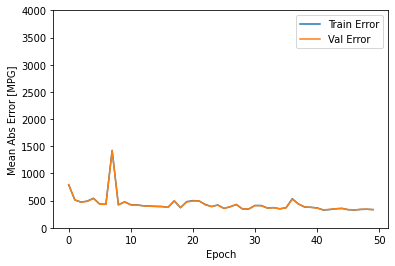

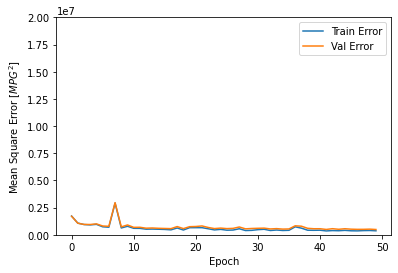

In [ ]:
plot_history(all_history[4][4], abslim=4e3, sqrtlim=2e7)

En este caso estoy dejando el rango de los ejes con los mismos valores que el problema anterior para una justa comparación. Sin embargo, como los valores de entrenamiento y validación están muy cercanos vuelvo a desplegar el gráfico para mostrar las diferencias en un rango que le dé mejor resolución a las curvas.

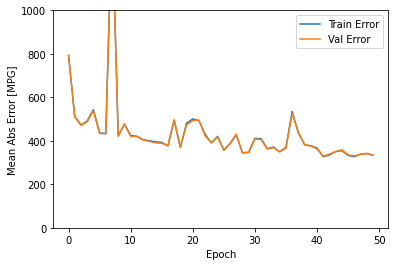

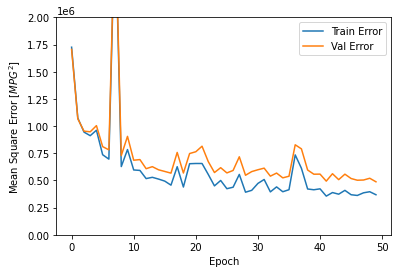

In [ ]:
plot_history(all_history[4][4], abslim=1e3, sqrtlim=2e6)

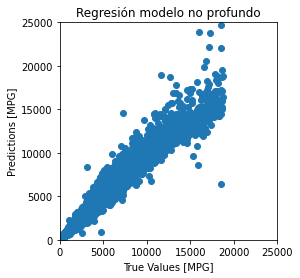

In [ ]:
y_pred, y_true = predict(best_mlp, test_loader)
plot_regresion(y_true, y_pred, 'Regresión modelo no profundo', axis=[25e3, 25e3])

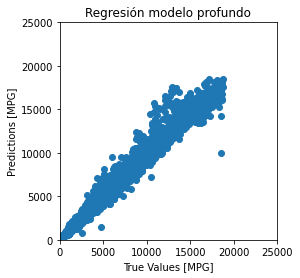

In [ ]:
y_pred, y_true = predict(best_deepmlp, test_loader)
plot_regresion(y_true, y_pred, 'Regresión modelo profundo', axis=[25e3, 25e3])

In [ ]:
y_pred, y_true = predict(best_mlp, test_loader)
print(f'Valor R2 del modelo no profundo {R2(y_true, y_pred):.4f}')
y_pred, y_true = predict(best_deepmlp, test_loader)
print(f'Valor R2 del modelo profundo {R2(y_true, y_pred):.4f}')

Valor R2 del modelo no profundo 0.9583
Valor R2 del modelo profundo 0.9792


La evolución de las métricas del modelo profundo se encuentra en un rango mucho menor a la de las del modelo no profundo, en especial en las primeras épocas. Se nota una convergencia rápida también a comparación. Esta tendencia se mantiene con un valor $R^2$ de ajuste del modelo profundo más alta, mostrando a los puntos del gráfico de precio vs precio más agrupados en una recta y=x.

Como conclusión, y explicación a la mejora, se puede ver que en este caso se aprovecha bien la complejidad extra que ofrece el modelo profundo para solucionar el problema, logrando resultados más precisos. 

##Asignación de puntajes

**Puntaje por un entrenamiento de varios modelos variando capas y tamaño de neuronas: 0.2**

**Puntaje por tablas de mae y mse en el set de validación: 0.2**

**Puntaje por prueba del mejor modelo de validación en test: 0.1**

**Puntaje por gráficos de evolución de métricas del mejor modelo: 0.1**

**Puntaje por gráficos de precio vs precio: 0.1**

**Puntaje por cálculo de valor $R^2$: 0.1**

**Puntaje por análisis comparativo: 0.2**

#Pregunta 5

In [ ]:
#Descarga del ambiente (RUN ME!)
%%bash
pip install gym pyvirtualdisplay > /dev/null 2>&1
apt-get install -y xvfb python-opengl ffmpeg > /dev/null 2>&1
apt-get update > /dev/null 2>&1
apt-get install cmake > /dev/null 2>&1
pip install --upgrade setuptools 2>&1
pip install ez_setup > /dev/null 2>&1
pip install gym[atari] > /dev/null 2>&1
pip3 install box2d-py

  Attempting uninstall: setuptools
    Found existing installation: setuptools 57.2.0
    Uninstalling setuptools-57.2.0:
      Successfully uninstalled setuptools-57.2.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
#@title Importes (RUN ME TOO!)
import gym
from gym import logger as gymlogger
from gym.wrappers import Monitor
gymlogger.set_level(40) #error only
import tensorflow as tf
import numpy as np
import random
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import math
import glob
import io
import base64
from IPython.display import HTML

from IPython import display as ipythondisplay

from pyvirtualdisplay import Display
display = Display(visible=0, size=(1400, 900))
display.start()

env = gym.make("Pendulum-v0")

def average_episodic_return(env, agent, episodes=10, max_steps_per_episode=500):
    episode_rewards = []
    for episode in range(episodes):
        total_rewards = 0
        obs = env.reset()
        for t in range(max_steps_per_episode):
            out = agent(obs) # we don't care about the probabilities here
            assert ("Action" in out), "The key 'Action' was missing from the agents output."
            obs, rew, done, _ = env.step(out["Action"])
            total_rewards += rew
            # check if we are done, if so, exit loop
            if done:
                break
                
        episode_rewards.append(total_rewards)
        
    return {
        "AverageEpisodicReturn": np.mean(episode_rewards), 
        "StandardDeviation":np.sqrt(np.var(episode_rewards))
    }

from collections import deque
import matplotlib.animation
import matplotlib.pyplot as plt
%matplotlib inline

def animate_agent(env, agent, max_steps = 400):
    obs = env.reset()
    frames = deque()
    frames.append(env.render(mode='rgb_array'))
    for _ in range(max_steps):
        out = agent(obs)
        assert ("Action" in out), "The key 'Action' was missing from the agents output."
        action = out["Action"]
        obs, _ , done, _ = env.step(action)
        frames.append(env.render(mode='rgb_array'))
        if done:
            break
            
    return animate_frames(frames)

def animate_frames(frames):
    new_height = 2.2
    original_height = frames[0].shape[0]
    original_width = frames[0].shape[1]
    new_width = (new_height / original_height) * original_width
    fig = plt.figure(figsize=(new_width, new_height), dpi = 120)
    
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    patch = ax.imshow(frames[0], aspect='auto', animated=True, interpolation='bilinear')
    animate = lambda i: patch.set_data(frames[i])
    
    ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(frames), interval = 50)
    
    plt.close()
    return HTML(ani.to_jshtml())

def state_for(observation):
    ranges = [np.arange(-1, 1.25, 0.25), np.arange(-0.3, 0.375, 0.075)[:9], np.arange(-1, 1.25, 0.25)]
    state = np.zeros((3,)) #Ignorando el primer sensor
    for i, (obs, limits) in enumerate(zip(observation[1:], ranges)):
        if obs < limits[0]:
            state[i] = 0
            continue
        for j in range(1, len(limits) - 1):
            if limits[j] <= obs <= limits[j+1]:
                state[i] = j
                break
        if obs > limits[len(limits) - 1]:  
            state[i] = len(limits)

    currstate = 0

    for i in range(3): 
        currstate += state[i] * (10 ** i)

    return int(currstate)

In [ ]:
observation = env.reset()
print(f'observation {observation}')

observation [-0.6836447  -0.729815   -0.80727075]


In [ ]:
import time
import datetime
import sys
start = time.time()
neps = 1000
observations = []
for ep in range(neps):
    observation = env.reset()
    done = False
    while not done:
        env.render()
        observation, reward, done, info = env.step(env.action_space.sample())
        observations.append(observation)

    if ep%100 == 0:
        checkpoint = time.time()
        mean_ep_time = (checkpoint - start) / (ep + 1)
        msj = "Training {:.2f}% complete ETA {}"
        msj = msj.format((ep+1)/neps*100, datetime.timedelta(seconds=int((neps - ep) * mean_ep_time)))
        for i in range(len(msj)):
            sys.stdout.write('\r')
        sys.stdout.write(msj)

observations = np.array(observations).transpose()

Training 90.10% complete ETA 0:00:30

Para tener buenos histogramas necesitamos una cantidad de repeticiones alta. En este caso se seleccionan 1000 episodios (considerando igual que cada episodio presenta una gran cantidad de datos). Además, utilizamos una resolución de 100 rangos por histograma, aprovechando la abundancia de los datos, para ver si existen puntos relevantes de corte. Veremos que esta exagerada resolución no es necesaria, pero es importante tener buenos estudios cuando no estamos familiarizados con las particularidades de las variables de nuestro problema.

Para visitar los estados utilizamos la función `env.action_space.sample()`. Veremos que en el histograma de acciones dicha función tiene una distribución uniforme. Explorar el espacio con esta función no nos dará todas las soluciones, pero como método de Montecarlo nos entregará valores relativamente representativos de lo que sucede con los sensores.

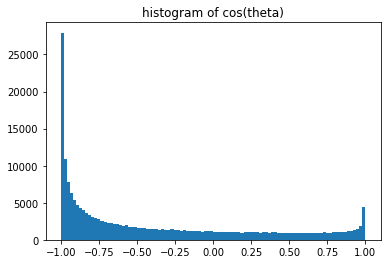

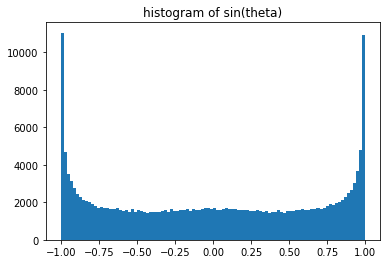

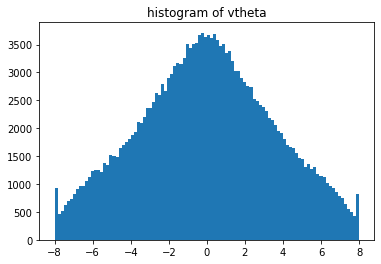

In [ ]:
from matplotlib import pyplot as plt

sensors = ['cos(theta)', 'sin(theta)', 'vtheta']

for (colname, series) in zip(sensors, observations):
    plt.hist(series, bins=100) 
    plt.title(f'histogram of {colname}') 
    plt.show()


**Puntaje por el histograma: 0.3**

Para discretizar los valores de los sensores necesitamos tener en cuenta un balance entre la resolución de la discretización, y la cantidad de combinaciones agregadas a la matriz Q. Si la discretización es pobre, o de baja resolución, no seremos capaces de reaccionar bien a las particularidades del problema en casos críticos, incluso si es mucho, no obtendremos un buen comportamiento en ningún caso. Por otro lado, una exageración en la cantidad de estados debido a una alta resolución nos obligará a requerir muchas más repeticiones para obtener buena convergencia de la matriz Q, y para poder visitar los estados de baja probabilidad de ocurrencia.

Para este caso se decide construir una discretización con 6 valores discretos para los valores seno y coseno del ángulo, y con 10 valores discretos para la velocidad del ángulo. Para los valores seno y coseno existe un valle plano de baja probabilidad de ocurrencia cercano a 0 en ambos casos, y alta probabilidad de ocurrencia en los extremos. Los intervalos en los extremos se definen más angostos por tener alta probabilidad, mientras que aquellos en el valle quedan más anchos. En el caso de la velocidad, se define una distribución homogénea de los rangos, sin importar la probabilidad debido a que es una variable a la que se le está dedicando más resolución en general, y se piensa que es más crítica.

In [ ]:
#@title State Function

def state_for(observation):
    state_vector = [0]*3
    state_name = ['cos(theta)', 'sin(theta)', 'vtheta']
    for (i, (sensor, value)) in enumerate(zip(state_name, observation)):
        if sensor == 'cos(theta)': 
            if value < -0.9:
                state_vector[i] = 0
            elif -0.9 <= value and value < -0.75:
                state_vector[i] = 1
            elif -0.75 <= value and value < 0:
                state_vector[i] = 2
            elif 0 <= value and value < 0.75:
                state_vector[i] = 3
            elif 0.75 <= value and value < 0.9:
                state_vector[i] = 4
            else: # 0.9 < value
                state_vector[i] = 5
        if sensor == 'sin(theta)': 
            if value < -0.9:
                state_vector[i] = 0
            elif -0.9 <= value and value < -0.75:
                state_vector[i] = 1
            elif -0.75 <= value and value < 0:
                state_vector[i] = 2
            elif 0 <= value and value < 0.75:
                state_vector[i] = 3
            elif 0.75 <= value and value < 0.9:
                state_vector[i] = 4
            else: # 0.9 < value
                state_vector[i] = 5
        if sensor == 'vtheta': 
            if value < -6:
                state_vector[i] = 0
            elif -6 <= value and value < -4:
                state_vector[i] = 1
            elif -4 <= value and value < -2:
                state_vector[i] = 2
            elif -2 <= value and value < -1:
                state_vector[i] = 3
            elif -1 <= value and value < 0:
                state_vector[i] = 4
            elif 0 <= value and value < 1:
                state_vector[i] = 5
            elif 1 <= value and value < 2:
                state_vector[i] = 6
            elif 2 <= value and value < 4:
                state_vector[i] = 7
            elif 4 <= value and value < 6:
                state_vector[i] = 8
            else: # 6 < value
                state_vector[i] = 9


    digits = np.array([1, 6, 36]) #Tabla de transformación a base 10
    state_vector = np.array(state_vector)

    return digits.dot(state_vector)
                              
nS = (6 ** 2) * 10 #Número de estados



Con todos los sensores operando se tiene una combinatoria de espacios de 6x6x10. Para representar esa combinatoria en números naturales nos conviene una transformación tipo lógica digital. Lamentablemente no tenemos una base constante, por lo que la sumatoria de los elementos tiene que ser ponderada para poder utilizar todos los naturales desde 0 hasta 360. 

Con ello, finamente contamos con una función que transforma una tupla de datos flotantes a un número discreto entre 0 y 359.

In [ ]:
observation = env.reset()
state_curr = state_for(observation)
print(f'observation {observation}')
print(f'discretization {state_curr}')

observation [-0.75267963 -0.65838695 -0.71939206]
discretization 261


**Puntaje por la función de observación: 0.5**

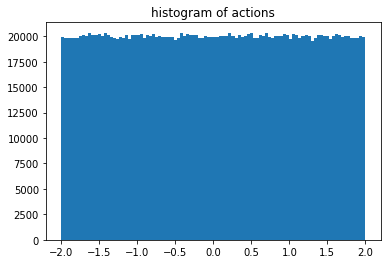

In [ ]:
neps = 2000000
actions = [0]*neps

for ep in range(neps):
    actions[ep] = env.action_space.sample()

actions = np.array(actions)
plt.hist(actions, bins=100) 
plt.title(f'histogram of actions') 
plt.show()

Como se adelantó más arriba, efectivamente el histograma de esta función es plano, por lo que resulta sencillo definir una discretización. Como esta discretización va del agente al ambiente, transformaremos un índice en un valor de torque en punto flotante. Para ello definimos una resolución de 8 rangos.

In [ ]:
#@title Action Function

def action_for(index):
    action = np.array([-1.75, -1.25, -0.75, -0.25, 0.25, 0.75, 1.25, 1.75])
    return action[index]

nA = 8

**Puntaje por la función de acción: 0.2**

#Pregunta 6

In [ ]:
def random_agent(state, Q, epsilon=0):
    prob = 1/env.observation_space.shape[0]
    return {'Action' : env.action_space.sample(), 'Probability' : prob}

In [ ]:
#@title animate_agent
def animate_agent(env, agent, Q, max_steps = 400):
    obs = env.reset()
    frames = deque()
    frames.append(env.render(mode='rgb_array'))
    for _ in range(max_steps):
        state = state_for(obs)
        out = agent([state], Q, epsilon=0)
        assert ("Action" in out), "The key 'Action' was missing from the agents output."
        action = out["Action"]
        obs, _ , done, _ = env.step(action)
        frames.append(env.render(mode='rgb_array'))
        if done:
            break
            
    return animate_frames(frames)

In [ ]:
animate_agent(env, random_agent, None)

In [ ]:
#@title average_episodic_return
def average_episodic_return(env, agent, Q, episodes=10, max_steps_per_episode=500):
    episode_rewards = [0]*episodes
    for episode in range(episodes):
        total_rewards = 0
        obs = env.reset()
        for t in range(max_steps_per_episode):
            state = state_for(obs)
            try:
                out = agent([state], Q, epsilon=0) # we don't care about the probabilities here
            except:
                print([state])
                print(obs)
                out = 0
            assert ("Action" in out), "The key 'Action' was missing from the agents output."
            obs, rew, done, _ = env.step(out["Action"])
            total_rewards += rew
            # check if we are done, if so, exit loop
            if done:
                break
                
        episode_rewards[episode] = total_rewards
        
    return {
        "AverageEpisodicReturn": np.mean(episode_rewards), 
        "StandardDeviation": np.sqrt(np.var(episode_rewards))
    }

In [ ]:
average_episodic_return(env, random_agent, None)

{'AverageEpisodicReturn': -1268.3061764843656,
 'StandardDeviation': 254.41026633777338}

**Puntaje por agente aleatorio con animación: 0.1**

In [ ]:
#@title Agent e-greedy
import random as rd

def agent_eg(state, Q, epsilon=0.1):
    explore = rd.random()
    if len(state) > 1:
        state = state_for(state)
    if explore <= epsilon:
        index = rd.randint(0, nA - 1) #Exploracion
        action = action_for(index)
        prob = epsilon
    else:
        index = np.argmax(Q[state]) #Política greedy
        action = action_for(index)
        prob = 1 - epsilon

    return {'Action' : [action], 'Probability' : prob, 'ActionIndex': index}

**Puntaje por agente: 0.2**

Si el agente no hace exploración, o no está implementada en el método de q-learning se reduce en 0.1 en alguno de estos lugares.

In [ ]:
#@title Exploration policies

def e_greedy_policy(episode, epsilon=0.2): 
    return epsilon

def piecewise_policy(episode): 
    if episode < 100:
        return 0.5
    elif 100 <= episode and episode < 500:
        return 0.2
    elif 500 <= episode and episode < 2500:
        return 0.1
    elif 2500 <= episode and episode < 7500:
        return 0.01
    return 0    

<H2>Q-learning</H2>
Inicializar $Q(s, a), \forall s \in S, a \in A(s)$ de manera arbitraria y $Q(estado\: terminal, .) = 0$<br>
Repetir (para cada episodio):<br>
$\quad$ Inicializar S<br>
$\quad$ Repetir (para cada paso de cada episorio)<br>
$\quad \quad$ Escoger $a$ desde $s$ utilizando la política derivada de $Q$ (por ejemplo $\epsilon$-greedy)<br>
$\quad \quad$ Tomar acción $a$, observar $r$, $s'$<br>
$\quad \quad Q(s,a) \leftarrow Q(s,a) + \alpha [r + \gamma \max_{a'} Q(s', a') - Q(s,a) ] $<br>
$\quad \quad s \leftarrow s'$<br>
$\quad \quad $ Hasta que $s$ sea terminal.

In [ ]:
#@title q_learning
import time
import datetime
import sys

def q_learning(nepisodes, agent, Q, exp_policy, alpha=0.5, gamma=0.9):
    rewards = [0]*nepisodes
    average_rewards = [0]*nepisodes
    start = time.time()
    eptime = int(nepisodes/10)
    vis = np.zeros_like(Q)

    for ep in range(nepisodes):
        episodic_reward = 0
        done = False
        observation = env.reset()
        state_curr = state_for(observation)
        epsilon = exp_policy(ep)

        while not done:
            env.render()

            decition = agent([state_curr], Q, epsilon=epsilon)
            action, prob, action_idx = decition['Action'], decition['Probability'], decition['ActionIndex']
            observation, reward, done, info = env.step(action)
            state_future = state_for(observation)
            Q[state_curr, action_idx] += alpha * (reward + gamma*max(Q[state_future, :]) - Q[state_curr, action_idx]) 
            vis[state_curr, action_idx] = 1
            state_curr = state_future
            episodic_reward += reward            

        rewards[ep] = episodic_reward
        average_reward = average_episodic_return(env, agent, Q)
        average_rewards[ep] = average_reward['AverageEpisodicReturn']

        if ep%eptime == 0:
            checkpoint = time.time()
            mean_ep_time = (checkpoint - start) / (ep + 1)
            msj = "Training {:.2f}% complete ETA {}"
            msj = msj.format((ep+1)/nepisodes*100, datetime.timedelta(seconds=int((nepisodes - ep) * mean_ep_time)))
            for i in range(len(msj)):
                sys.stdout.write('\r')
            sys.stdout.write(msj)

    env.close()
    stop = time.time()
    print('')
    print("Total time = ", datetime.timedelta(seconds=int(stop-start)))
    print(f'Number of visited states {vis.sum()}')

    return Q, {'episodes': nepisodes, 'Episodic Rewards': rewards, 'Average Episodic Rewards': average_rewards}

**Puntaje por implementación del método: 0.3**

In [ ]:
#@title Q(estadoterminal,.)=0
def inic_terminal(Q, nepisodes):
    print('Initializing Q´s terminal estates')
    eptime = int(nepisodes/10)
    start = time.time()
    for ep in range(nepisodes):
        done = False
        observation = env.reset()
        state_curr = state_for(observation)

        while not done:
            env.render()
            action = env.action_space.sample()
            observation, reward, done, info = env.step(action)
            state = state_for(observation)

        for i in range(8):
            Q[state, i] = 0

        if ep%100 == 0:
            checkpoint = time.time()
            mean_ep_time = (checkpoint - start) / (ep + 1)
            msj = "Training {:.2f}% complete ETA {}"
            msj = msj.format((ep+1)/nepisodes*100, datetime.timedelta(seconds=int((nepisodes - ep) * mean_ep_time)))
            for i in range(len(msj)):
                sys.stdout.write('\r')
            sys.stdout.write(msj)

    env.close()
    stop = time.time()
    print('')
    print("Total time = ", datetime.timedelta(seconds=int(stop-start)))

    return Q

A continuación se presentan dos versiones de entrenamiento. Una con política de exploración &epsilon;-greedy y la otra con Picewise &epsilon;-greedy. La primera tiene la convergencia asegurada por demostración matemática [1]

##Solución con &epsilon;-greedy

In [ ]:
#Entrenamiento de 10 episodios

Qa = np.random.rand(nS, nA)
history_a = {'Episodic Rewards': [], 'Average Episodic Rewards': [], 'Q': []}
epsilon = 0.2
alpha = 0.1
gamma = 0.95

Qa, history = q_learning(10, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 10 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 100.00% complete ETA 0:00:00
Total time =  0:00:05
Number of visited states 920.0
Luego de 10 episodios
{'AverageEpisodicReturn': -1225.6561228176627, 'StandardDeviation': 252.41727404426723}


In [ ]:
Qa, history = q_learning(10, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 20 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 100.00% complete ETA 0:00:00
Total time =  0:00:05
Number of visited states 985.0
Luego de 20 episodios
{'AverageEpisodicReturn': -1175.1502927741335, 'StandardDeviation': 338.2107445966209}


In [ ]:
Qa, history = q_learning(30, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 50 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 93.33% complete ETA 0:00:01
Total time =  0:00:15
Number of visited states 1277.0
Luego de 50 episodios
{'AverageEpisodicReturn': -1128.3914994747288, 'StandardDeviation': 433.2779472719348}


In [ ]:
Qa, history = q_learning(50, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 100 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 92.00% complete ETA 0:00:02
Total time =  0:00:25
Number of visited states 1372.0
Luego de 100 episodios
{'AverageEpisodicReturn': -1211.3523085221595, 'StandardDeviation': 216.51627340411858}


In [ ]:
Qa, history = q_learning(100, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 200 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 91.00% complete ETA 0:00:05
Total time =  0:00:50
Number of visited states 1424.0
Luego de 200 episodios
{'AverageEpisodicReturn': -1185.2049286299498, 'StandardDeviation': 410.46401443019016}


In [ ]:
Qa, history = q_learning(300, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 500 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 90.33% complete ETA 0:00:15
Total time =  0:02:32
Number of visited states 1475.0
Luego de 500 episodios
{'AverageEpisodicReturn': -1166.3854636254412, 'StandardDeviation': 231.00997259571142}


In [ ]:
Qa, history = q_learning(500, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 1000 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 90.20% complete ETA 0:00:25
Total time =  0:04:12
Number of visited states 1501.0
Luego de 1000 episodios
{'AverageEpisodicReturn': -1090.9279006389072, 'StandardDeviation': 354.9647038358794}


In [ ]:
Qa, history = q_learning(1000, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 2000 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 90.10% complete ETA 0:00:50
Total time =  0:08:26
Number of visited states 1502.0
Luego de 2000 episodios
{'AverageEpisodicReturn': -909.057149110059, 'StandardDeviation': 222.08677913772615}


In [ ]:
Qa, history = q_learning(3000, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 5000 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 90.03% complete ETA 0:02:32
Total time =  0:25:24
Number of visited states 1498.0
Luego de 5000 episodios
{'AverageEpisodicReturn': -408.1470735629154, 'StandardDeviation': 253.1789722556898}


In [ ]:
Qa, history = q_learning(5000, agent_eg, Qa, e_greedy_policy, alpha=alpha, gamma=gamma)
history_a['Q'].append(Qa.copy())
history_a['Episodic Rewards'] += history['Episodic Rewards']
history_a['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 10000 episodios')
print(average_episodic_return(env, agent_eg, Qa, episodes=100))
animate_agent(env, agent_eg, Qa)

Training 90.02% complete ETA 0:04:13
Total time =  0:42:16
Number of visited states 1494.0
Luego de 10000 episodios
{'AverageEpisodicReturn': -761.7953239404891, 'StandardDeviation': 94.08788788026693}


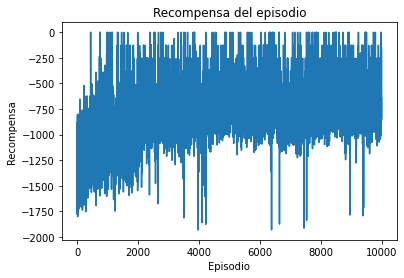

In [ ]:
eps = list(range(len(history_a['Episodic Rewards'])))
plt.plot(eps, history_a['Episodic Rewards'])
plt.title('Recompensa del episodio')
plt.xlabel('Episodio')
plt.ylabel('Recompensa')
plt.show()

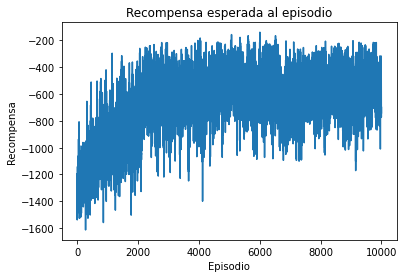

In [ ]:
plt.plot(eps, history_a['Average Episodic Rewards'])
plt.title('Recompensa esperada al episodio')
plt.xlabel('Episodio')
plt.ylabel('Recompensa')
plt.show()

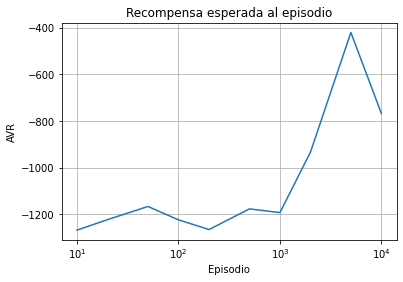

In [ ]:
ept = [10, 20, 50, 100, 200, 500, 1000, 2000, 5000, 10000]
avr = []

for q in history_a['Q']:
    rwd = average_episodic_return(env, agent_eg, q, episodes=100)
    avr.append(rwd['AverageEpisodicReturn'])

plt.plot(ept, avr)
plt.title('Recompensa esperada al episodio')
plt.xscale('symlog')
plt.grid(True)
plt.xlabel('Episodio')
plt.ylabel('AVR')
plt.show()

##Solución con Piecewise &epsilon;-greedy

In [ ]:
#Entrenamiento de 10 episodios

Qb = np.random.rand(nS, nA)
history_b = {'Episodic Rewards': [], 'Average Episodic Rewards': [], 'Q': []}
epsilon = 0.2
alpha = 0.1
gamma = 0.95

Qb, history = q_learning(10, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 10 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 100.00% complete ETA 0:00:00
Total time =  0:00:05
Number of visited states 971.0
Luego de 10 episodios
{'AverageEpisodicReturn': -1219.3107424708696, 'StandardDeviation': 340.8296343403461}


In [ ]:
Qb, history = q_learning(10, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 20 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 100.00% complete ETA 0:00:00
Total time =  0:00:05
Number of visited states 906.0
Luego de 20 episodios
{'AverageEpisodicReturn': -1203.7491830547892, 'StandardDeviation': 376.8905960080602}


In [ ]:
Qb, history = q_learning(30, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 50 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 93.33% complete ETA 0:00:01
Total time =  0:00:15
Number of visited states 1353.0
Luego de 50 episodios
{'AverageEpisodicReturn': -1294.5119054766365, 'StandardDeviation': 355.6843304255699}


In [ ]:
Qb, history = q_learning(50, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 100 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 92.00% complete ETA 0:00:02
Total time =  0:00:25
Number of visited states 1326.0
Luego de 100 episodios
{'AverageEpisodicReturn': -1134.5123593335718, 'StandardDeviation': 283.2076970166696}


In [ ]:
Qb, history = q_learning(100, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 200 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 91.00% complete ETA 0:00:05
Total time =  0:00:50
Number of visited states 1448.0
Luego de 200 episodios
{'AverageEpisodicReturn': -1084.8822682173789, 'StandardDeviation': 424.69136372996456}


In [ ]:
Qb, history = q_learning(300, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 500 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 90.33% complete ETA 0:00:15
Total time =  0:02:31
Number of visited states 1475.0
Luego de 500 episodios
{'AverageEpisodicReturn': -1115.780257293476, 'StandardDeviation': 405.492222398896}


In [ ]:
Qb, history = q_learning(500, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 1000 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 90.20% complete ETA 0:00:25
Total time =  0:04:12
Number of visited states 1480.0
Luego de 1000 episodios
{'AverageEpisodicReturn': -834.3476701268421, 'StandardDeviation': 171.49642836225013}


In [ ]:
Qb, history = q_learning(1000, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 2000 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 90.10% complete ETA 0:00:50
Total time =  0:08:25
Number of visited states 1504.0
Luego de 2000 episodios
{'AverageEpisodicReturn': -968.487519528547, 'StandardDeviation': 96.59278732777912}


In [ ]:
Qb, history = q_learning(3000, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 5000 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 90.03% complete ETA 0:02:30
Total time =  0:25:05
Number of visited states 1490.0
Luego de 5000 episodios
{'AverageEpisodicReturn': -264.0688885715839, 'StandardDeviation': 170.9371837873203}


In [ ]:
Qb, history = q_learning(5000, agent_eg, Qb, piecewise_policy, alpha=alpha, gamma=gamma)
history_b['Q'].append(Qb.copy())
history_b['Episodic Rewards'] += history['Episodic Rewards']
history_b['Average Episodic Rewards'] += history['Average Episodic Rewards']
print('Luego de 10000 episodios')
print(average_episodic_return(env, agent_eg, Qb, episodes=100))
animate_agent(env, agent_eg, Qb)

Training 90.02% complete ETA 0:04:08
Total time =  0:41:28
Number of visited states 1492.0
Luego de 10000 episodios
{'AverageEpisodicReturn': -281.25039039094196, 'StandardDeviation': 162.52772705242762}


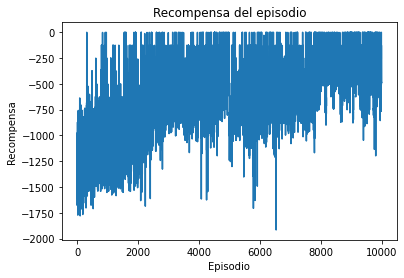

In [ ]:
eps = list(range(len(history_b['Episodic Rewards'])))
plt.plot(eps, history_b['Episodic Rewards'])
plt.title('Recompensa del episodio')
plt.xlabel('Episodio')
plt.ylabel('Recompensa')
plt.show()

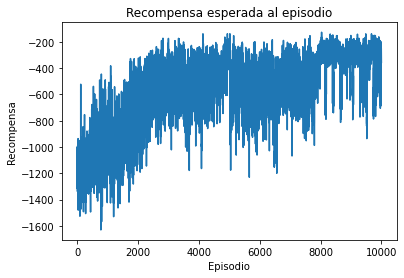

In [ ]:
plt.plot(eps, history_b['Average Episodic Rewards'])
plt.title('Recompensa esperada al episodio')
plt.xlabel('Episodio')
plt.ylabel('Recompensa')
plt.show()

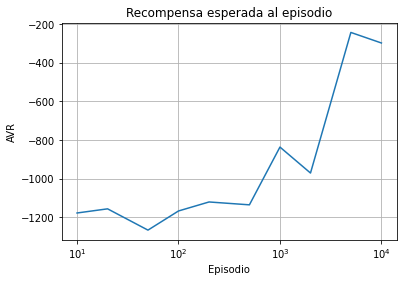

In [ ]:
ept = [10, 20, 50, 100, 200, 500, 1000, 2000, 5000, 10000]
avr = []

for q in history_b['Q']:
    rwd = average_episodic_return(env, agent_eg, q, episodes=100)
    avr.append(rwd['AverageEpisodicReturn'])

plt.plot(ept, avr)
plt.title('Recompensa esperada al episodio')
plt.xscale('symlog')
plt.grid(True)
plt.xlabel('Episodio')
plt.ylabel('AVR')
plt.show()

##Otras asignaciones de puntaje

**Puntaje por correcto entrenamiento: 0.2**

**Puntaje por gráficos: 0.2**

#Pregunta 7

El algoritmo de DeepQ fue propuesto por Mnih et. al. [4]. Para la época existían aproximaciones de funciones para la matriz Q en la versión clásica de q-learning [2]. Estas aproximaciones, construidas muchas veces a mano, ayudaban a reducir los requerimientos de memoria para la matriz Q, cuando el problema tenía muchas combinaciones de estados y acciones. Con el advenimiento de los algoritmos de aprendizaje profundo, los autores decidieron construir la aproximación de Q utilizando una red neuronal profunda. 


En una red neuronal se puede aproximar la matriz Q agregando a la entrada tanto el valor de estado, sin necesidad de discretizar, como el valor de la acción. La salida de la red es el valor de la matriz Q, que se puede ajustar mediante una regresión [3]. 

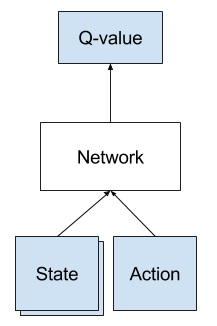



En un problema con acciones discretas, se puede construir una capa de salida de la red con una neurona arrojando el valor q* para cada acción. Esto facilita hallar la acción óptima de $Q(s,a)$, pues solamente se tiene que encontrar el $Argmax_a Q(s, a)$ en la última capa mantieniendo el problema de regresión [3]. 

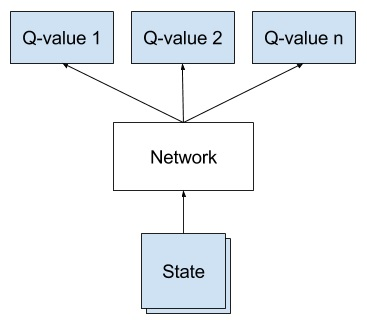

**Puntaje por arquitectura general con diseño action* = Argmax Q(estado, acciones): 0.3**

Sin embargo, es importante encontrar una valorización apropiada de los estados intermedios con respecto a los estados finales. Para determinar la valorización del estado anterior se utiliza la misma red neuronal (similar a redes siamesas, sin propagación de gradientes entre ellas, con una red target y otra de prediction), con el ya conocido parámetro $\gamma$. Y la construcción de la función de valor ahora depende de si el estado es terminal o no [1].

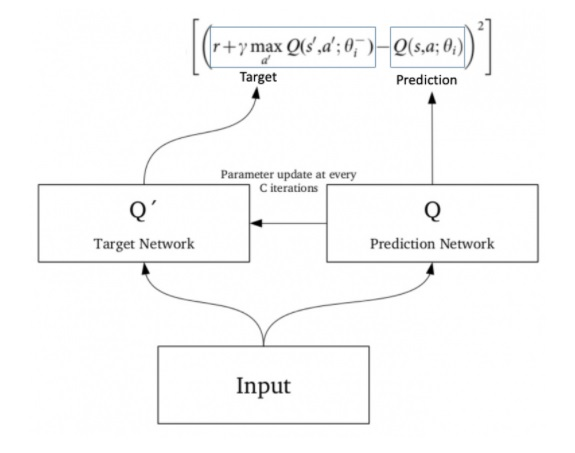

Finalmente, una contribución importante de los autores es la definición de una memoria de *replay*. En vez de hacer constantes interacciones con el sistema para una propagación del gradiente, lo que se hace es guardar algunas de estas interacciones para samplearlas luego en minibatches, y utilizar SGD (y sus variantes) para la propagación del gradiente. Esto realiza un intercambio de cómputo de simulación, por cómputo de gradientes en la red, con la ventaja de los métodos de paralelización que se aplican a las redes neuronales, y la aceleración por GPU.

**Puntaje por la memoria de replay: 0.2**

El algoritmo general en pseudocódigo presentado en [4] es el siguiente:

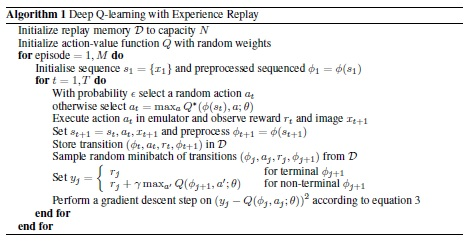

**Puntaje por algoritmo completo o en pseudocódigo: 0.2**

Si falta la actualización de valor target $y_j$ es 0.1

El algoritmo actualmente se encuentra patentado [5].

A continuación se presentan implementaciones de Pytorch para la red neuronal de DeepQ, y la memoria de replay

In [ ]:
#@title ReplayMemory class

class ReplayMemory(Dataset):
    def __init__(self, memory):
        self.replay_memory = {'paststates' : [], 
                      'actions' : [], 
                      'states' : [], 
                      'rewards' : [], 
                      'isfinal': []}
        
        self.paststates = torch.Tensor(memory['paststates'])
        self.actions = torch.Tensor(memory['actions'])
        self.states = torch.Tensor(memory['states'])
        self.rewards = torch.Tensor(memory['rewards'])
        self.isfinal = torch.Tensor(memory['isfinal'])

    def __getitem__(self, idx):
        
        return self.paststates[idx], self.actions[idx], self.states[idx], self.rewards[idx], self.isfinal[idx]

    def __len__(self):
        return len(self.paststates)

**Puntaje por memoria de replay: 0.1**

In [ ]:
#@title DeepQ class
from collections import OrderedDict
#device must be global
class DeepQ(nn.Module):
    def __init__(self, observation_space, action_space, opti_params, criterion):
        super().__init__()
        arch_small = OrderedDict([('input', nn.Linear(observation_space, 64)),
                         ('relu1', nn.LeakyReLU(negative_slope=0.2)),
                         ('hidden1', nn.Linear(64, 32)),
                         ('relu2', nn.LeakyReLU(negative_slope=0.2)),
                         ('hidden2', nn.Linear(32, 32)),
                         ('relu3', nn.LeakyReLU(negative_slope=0.2)),
                         ('hidden3', nn.Linear(32, 32)),
                         ('relu4', nn.LeakyReLU(negative_slope=0.2)),
                         ('hidden4', nn.Linear(32, 32)),
                         ('relu5', nn.ReLU()),
                         ('drop1', nn.Dropout(0.25)),
                         ('hidden5', nn.Linear(32, 16)),
                         ('relu6', nn.ReLU()),
                         ('drop2', nn.Dropout(0.25)),
                         ('output', nn.Linear(16, action_space))])
        
        self.mlp = nn.Sequential(arch_small).to(device) 
        self.observation_space = observation_space
        self.action_space = action_space
        self.replay_memory = {'paststates' : [], 
                              'actions' : [], 
                              'states' : [], 
                              'rewards' : [], 
                              'isfinal': []}

        if opti_params['opti'] == 'sgd':
            optimizer = SGD(self.mlp.parameters(), lr=opti_params['lr'])
        elif opti_params['opti'] == 'adam':
            optimizer = Adam(self.mlp.parameters(), lr=opti_params['lr'])
        elif opti_params['opti'] == 'rms':
            optimizer = RMSprop(self.mlp.parameters(), lr=opti_params['lr'], 
                                eps=1e-7, weight_decay=1e-4)    
        
        self.optimizer = optimizer
        self.criterion = criterion

    def forward(self, state):
        return self.mlp(state)

    def appendMemory(self, paststate, action, state, reward, isfinal):
        self.replay_memory['paststates'] += paststate
        self.replay_memory['actions'] += action
        self.replay_memory['states'] += state
        self.replay_memory['rewards'] += reward
        self.replay_memory['isfinal'] += isfinal
    
    def fit(self, 
            paststate : Tensor, 
            action : Tensor, 
            state : Tensor, 
            reward : Tensor, 
            gamma : float, 
            notfinalstate : Tensor):
      
        self.train()

        q_actions_past = self.mlp(paststate)
        q_actions_pres = self.mlp(state)
        max_val_pres = q_actions_pres.max(dim=1)
        max_val_pres = max_val_pres.values.reshape((max_val_pres.values.shape[0], 1))
        
        #La valorización de la recompensa depende de si el estado es terminal o no
        expand_rwd = torch.ones((1, self.action_space)).to(device)
        criterion_shape = to_categorical(action, self.action_space).to(device)
        notfinalstate = notfinalstate.reshape((notfinalstate.shape[0], 1))
        
        yn = criterion_shape.clone() * torch.matmul(reward.unsqueeze(1), expand_rwd)
        update_trans_state = gamma * criterion_shape.clone()
        update_trans_state *= torch.matmul(notfinalstate, expand_rwd) 
        update_trans_state *= torch.matmul(max_val_pres, expand_rwd)
        yn += update_trans_state
        ys = criterion_shape.clone() * q_actions_past

        self.optimizer.zero_grad()
        loss = self.criterion(ys, yn)
        loss.backward()
        self.optimizer.step()

        return loss.item()

def to_categorical(y : Tensor, num_classes : int):
    y_cat = torch.zeros(y.shape[0], num_classes)
    for (i, num) in enumerate(y):
        y_cat[i][int(num.item())] = 1
    
    return y_cat

**Puntaje por la red neuronal: 0.2**

No es necesario agregar una función fit, pero es deseable por lo que puede subir algún puntaje perdido. Recordemos que es una pregunta bono.

#Referencias

[1] Ankit Choudhary, 18 de Abril de 2019, *A Hands-On Introduction to Deep Q-Learning using OpenAI Gym in Python*, https://www.analyticsvidhya.com/blog/2019/04/introduction-deep-q-learning-python/

[2] R. Sutton y A. Barto, *Reinforcement Learning: An Introduction* (2018), Ed. MIT Press

[3] Tambet Matiisen, 19 de Diciembre de 2015, *Demystifying deep reinforcement learnin*, https://neuro.cs.ut.ee/demystifying-deep-reinforcement-learning/

[4] V. Mnih, K. Kavukcuoglu, D. Silver, A. Graves, I. Antonoglou, D. Wierstra, M. Riedmiller, *Playing Atari with Deep Reinforcement Learning* (2013), arXiv:1312.5602

[5] Volodymyr Mnih, Koray Kavukcuoglu, (2013), *Methods and apparatus for reinforcement learning*  (U.S. Patent No. US20150100530A1), https://patents.google.com/patent/US20150100530